<a href="https://colab.research.google.com/github/kothapalliAnusha/Life_Expectancy_SPM/blob/main/SPM_CODING.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Implementation & Outputs**

# Installing required libraries and environments.

In [8]:
!apt-get update
#Download Java Virtual MAachine(JVM)
!apt-get install openjdk-11-jdk-headless -qq>/dev/null

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:3 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:6 https://ppa.launchpadcontent.net/c2d4u.team/c2d4u4.0+/ubuntu jammy InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Reading package lists... Done


In [9]:
!python -- version

python3: can't open file '/content/version': [Errno 2] No such file or directory


In [10]:
!pwd

/content


In [11]:
# Download Spark 3.4.0 from a different mirror
!wget https://archive.apache.org/dist/spark/spark-3.4.0/spark-3.4.0-bin-hadoop3.tgz

# Unzip the file
!tar xf spark-3.4.0-bin-hadoop3.tgz

--2024-04-27 07:26:42--  https://archive.apache.org/dist/spark/spark-3.4.0/spark-3.4.0-bin-hadoop3.tgz
Resolving archive.apache.org (archive.apache.org)... 65.108.204.189, 2a01:4f9:1a:a084::2
Connecting to archive.apache.org (archive.apache.org)|65.108.204.189|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 388407094 (370M) [application/x-gzip]
Saving to: ‘spark-3.4.0-bin-hadoop3.tgz’

spark-3.4.0-bin-had 100%[===================>] 370.41M  21.1MB/s    in 17s     

2024-04-27 07:27:00 (21.4 MB/s) - ‘spark-3.4.0-bin-hadoop3.tgz’ saved [388407094/388407094]



In [12]:
#Adds pyspark to sys.path at runtime
!pip install -q findspark

In [13]:
import os

# Set environment variables
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-11-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.4.0-bin-hadoop3"

# Initialize Spark
import findspark
findspark.init(spark_home="/content/spark-3.4.0-bin-hadoop3")

In [14]:
!ls

'Life Expectancy Data.csv'   sample_data   spark-3.4.0-bin-hadoop3   spark-3.4.0-bin-hadoop3.tgz


In [15]:
import findspark
findspark.init()

In [16]:
findspark.find()

'/content/spark-3.4.0-bin-hadoop3'

In [17]:
!pip install pyspark

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 317.0/317.0 MB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyspark: filename=pyspark-3.5.1-py2.py3-none-any.whl size=317488491 sha256=c54b06915e8d7aec83fb737086e9f5ca5b4429af7eb6ab7ea7bf8a79cd6b5725
  Stored in directory: /root/.cache/pip/wheels/80/1d/60/2c256ed38dddce2fdd93be545214a63e02fbd8d74fb0b7f3a6
Successfully built pyspark


In [18]:
from pyspark import SparkConf
from pyspark.context import SparkContext
sc=SparkContext.getOrCreate(SparkConf().setMaster("local[*]"))

In [19]:
sc

<SparkContext master=local[*] appName=pyspark-shell>

In [20]:
from pyspark.sql import SparkSession
#Connect spark code on top of spark engine
spark=SparkSession.builder.master("local[4]").getOrCreate()

In [21]:
import sys
from pyspark import SparkContext
from pyspark.sql import SQLContext
from pyspark.sql.types import Row,StructField,StructType,StringType,IntegerType
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [22]:
sqlContext=SQLContext(sc)
sqlContext

/content/spark-3.4.0-bin-hadoop3/python/pyspark/sql/context.py:112: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


In [23]:
spark=SparkSession.builder.appName("pySparkdf").getOrCreate()

In [24]:
spark=SparkSession.builder.appName("pySpark csv df").getOrCreate()

# **Loading the data**

In [25]:
df = spark.read.csv(header=True, inferSchema= True, path="/content/Life Expectancy Data.csv")
df.printSchema()
df.show(5)

root
 |-- Country: string (nullable = true)
 |-- Year: integer (nullable = true)
 |-- Status: string (nullable = true)
 |-- Life expectancy : double (nullable = true)
 |-- Adult Mortality: integer (nullable = true)
 |-- infant deaths: integer (nullable = true)
 |-- Alcohol: double (nullable = true)
 |-- percentage expenditure: double (nullable = true)
 |-- Hepatitis_B: integer (nullable = true)
 |-- Measles : integer (nullable = true)
 |--  BMI : double (nullable = true)
 |-- under-five deaths : integer (nullable = true)
 |-- Polio: integer (nullable = true)
 |-- Total expenditure: double (nullable = true)
 |-- Diphtheria : integer (nullable = true)
 |--  HIV/AIDS: double (nullable = true)
 |-- GDP: double (nullable = true)
 |-- Population: double (nullable = true)
 |--  thinness  1-19 years: double (nullable = true)
 |--  thinness 5-9 years: double (nullable = true)
 |-- Income composition of resources: double (nullable = true)
 |-- Schooling: double (nullable = true)

+-----------+--

#**Checking Null Values**

In [26]:
#check null values for all colums
for column in df.columns:
  null_count = df.filter(df[column].isNull()).count()
  print(f"Column:{column},Null Count:{null_count}")

Column:Country,Null Count:0
Column:Year,Null Count:0
Column:Status,Null Count:0
Column:Life expectancy ,Null Count:800
Column:Adult Mortality,Null Count:800
Column:infant deaths,Null Count:0
Column:Alcohol,Null Count:15520
Column:percentage expenditure,Null Count:0
Column:Hepatitis_B,Null Count:44240
Column:Measles ,Null Count:0
Column: BMI ,Null Count:2720
Column:under-five deaths ,Null Count:0
Column:Polio,Null Count:1520
Column:Total expenditure,Null Count:18080
Column:Diphtheria ,Null Count:1520
Column: HIV/AIDS,Null Count:0
Column:GDP,Null Count:35840
Column:Population,Null Count:52160
Column: thinness  1-19 years,Null Count:2720
Column: thinness 5-9 years,Null Count:2720
Column:Income composition of resources,Null Count:13360
Column:Schooling,Null Count:13040


#**Visualizations**

In [27]:
data = df.select('Country','Year','Alcohol','GDP','Population')

In [28]:
import matplotlib.pyplot as plt

In [29]:
def histogram(df,col,bins=10,xname=None,yname=None):
  '''
  This Function makes a histogram from spark dataframe named
  df for column name col.
  '''
  # Calculating histogram in spark
  vals=df.select(col).rdd.flatMap(lambda x:x).histogram(bins)
  # perprocessing histogram points and locations
  width=vals[0][1]-vals[0][0]
  loc=[vals[0][0]+(i+1)*width for i in range(len(vals[1]))]
  # making a bar plot
  plt.bar(loc,vals[1],width=width)
  plt.xlabel(col)
  plt.ylabel(yname)
  plt.show()

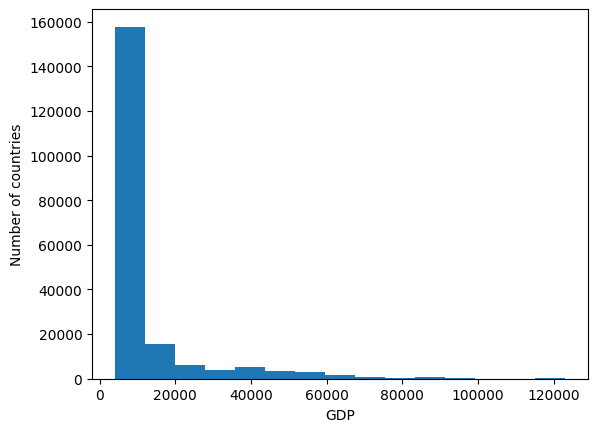

In [30]:
histogram(data,'GDP',bins=15, yname='Number of countries')

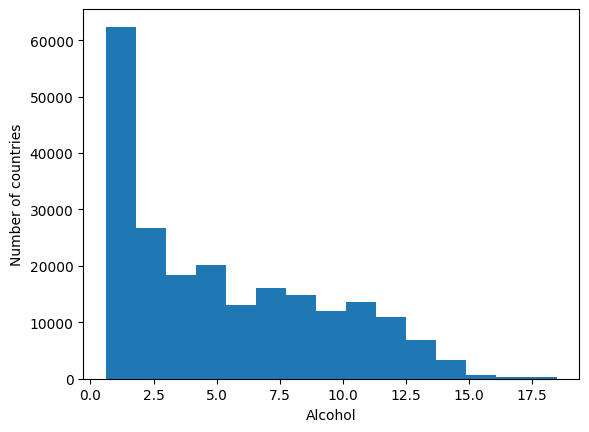

In [31]:
histogram(data,'Alcohol',bins=15, yname='Number of countries')

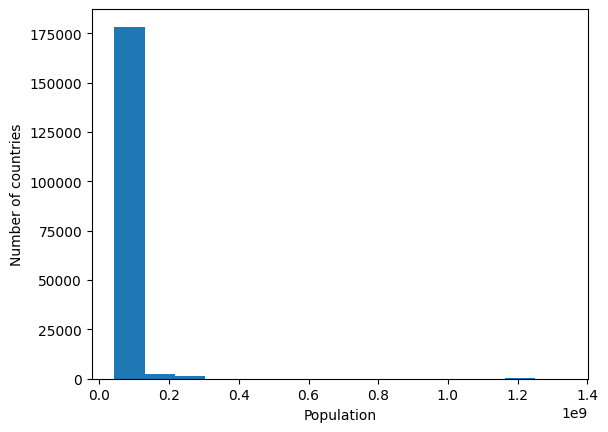

In [32]:
histogram(data,'Population',bins=15, yname='Number of countries')

In [33]:
data.select('Population').summary().show()

+-------+--------------------+
|summary|          Population|
+-------+--------------------+
|  count|              182880|
|   mean|1.2753375120052498E7|
| stddev|6.0998917093986265E7|
|    min|                34.0|
|    25%|            195553.0|
|    50%|           1388115.0|
|    75%|           7423289.0|
|    max|       1.293859294E9|
+-------+--------------------+



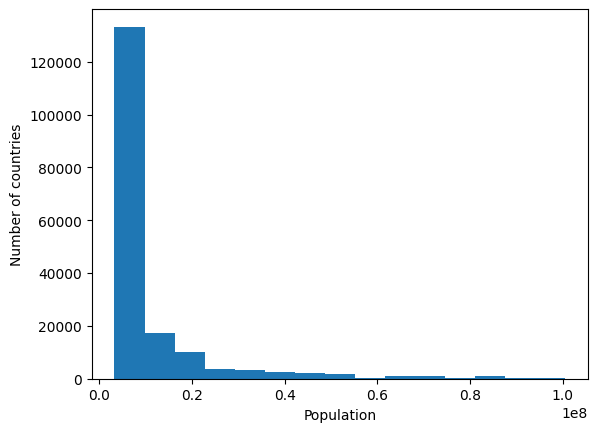

In [34]:
histogram(data.filter(df['Population']<100000000),\
          'Population',bins=15, yname='Number of countries')

In [35]:
def lineplot(df,x,y,measure='mean'):
  '''
  This function makes a line plot from Spark dataframe df with
  independent variable x and averaged over y.
  '''
  if measure=='mean':
    #Grouping the dataframe by x and averaging over y
    #Sorting is important because Spark shuffle the values
    #when doing the calculation
    pd_df=df.groupBy(x).mean(y).toPandas().sort_values(by=x)
    #Making plot using pandas
    pd_df.plot(x,'avg({})'.format(y),legend=False)
  elif measure =='total':
    pd_df=df.groupBy(x).sum(y).toPandas().sort_values(by=x)
    pd_df.plot(x, 'sum({})'.format(y), legend=False)
  elif measure =='count':
    pd_df=df.groupBy(x).count().toPandas().sort_values (by=x)
    pd_df.plot(x, 'count', legend=False)
  plt.ylabel(y)
  plt.show()

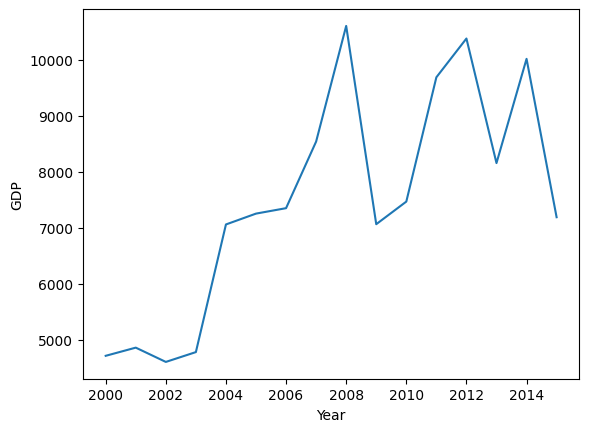

In [36]:
# Plot the data
lineplot(data,'Year','GDP',measure='mean')

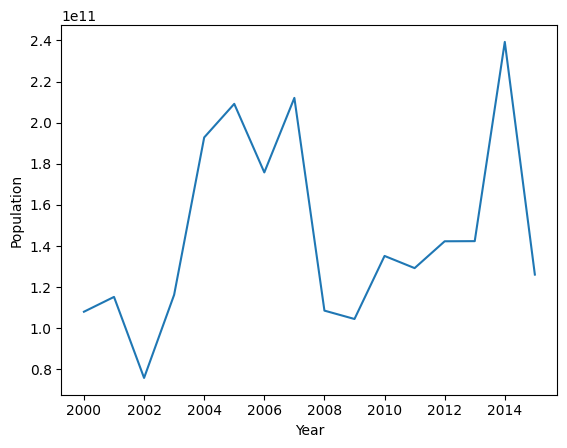

In [37]:
lineplot(data,'Year','Population',measure='total')

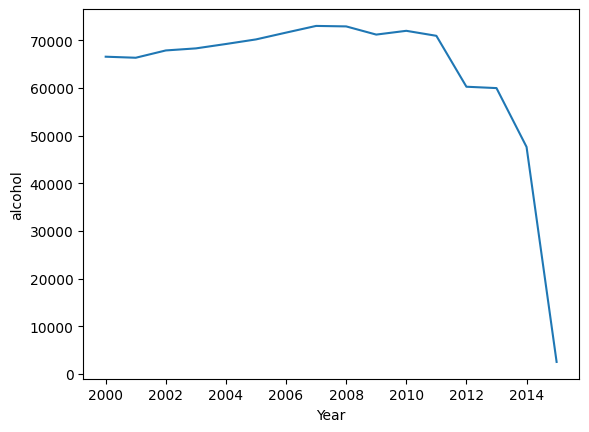

In [38]:
lineplot(data, 'Year', 'alcohol', measure='total')

In [39]:
def barplot(df,col,lim=10,yname=None):
  '''
  This Function makes a bar plot for the Spark dataframe df
  for categorical column col only selecting top categories
  as soecified by lim.
  '''
  # grouping by the categories,counting on each categories
  # and ordering them by the count
  classes=df.groupBy(col).count().orderBy('count',ascending=False)
  # take first 'lim' number of rows and convert to pandas
  pd_df=classes.limit(lim).toPandas()
  #Marking plot
  pd_df.plot(kind='bar',x=col,legend=False)
  plt.ylabel(yname)
  plt.show()

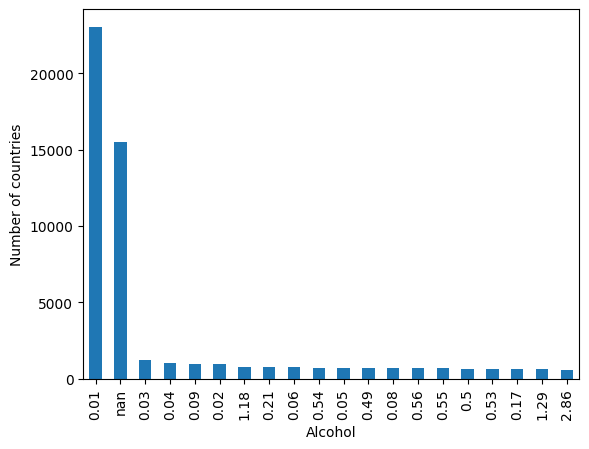

In [40]:
barplot(data,'Alcohol',lim=20, yname='Number of countries')

In [41]:
def boxplot(df,col,group_by,samp_size=10000):
  '''
  This Function makes a box plot for the Spark dataframe df
  grouping them by a column name called group_by and their
  aggrigate on another column called col.
  '''
  # Selecting sample for the large dataset
  # for small data sampling is not done. for the large data
  # sample size is the specified numaber
  true_samp_size=min(samp_size/df.count(),1.0)
  pd_df=df.sample(False,true_samp_size).toPandas()
  #Marking plot
  pd_df.boxplot(col,by=group_by,figsize=(8,5))
  plt.ylabel(col)
  plt.title(None)
  plt.show

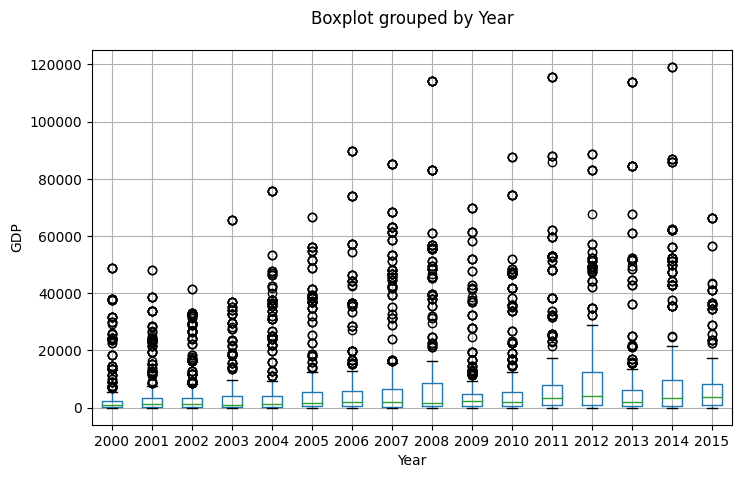

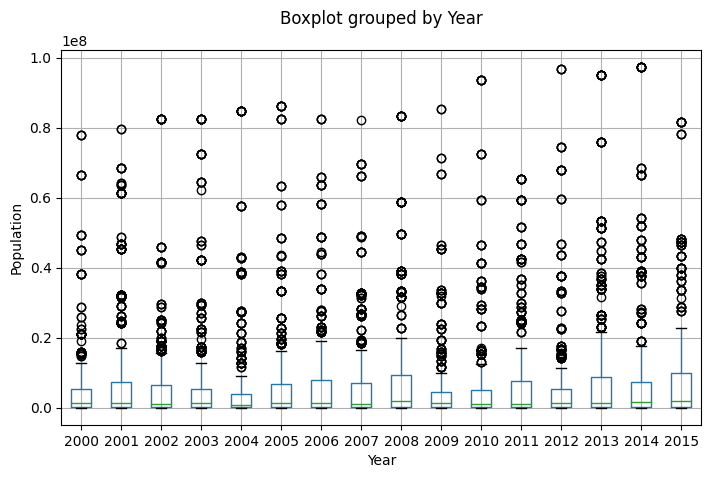

In [42]:
boxplot(data, 'GDP', 'Year')
boxplot(data.filter(df['Population']<100000000),'Population','Year')

#**Machine Learning Algorithms using Spark**

In [43]:
from pyspark.sql import SparkSession
import matplotlib.pyplot as plt
import seaborn as sns
!pip install pandas
import pandas as pd
!pip install my_module

  Preparing metadata (setup.py) ... done
  Created wheel for my_module: filename=my_module-1.6.2-py3-none-any.whl size=1404 sha256=f03f68ee4f365cd2c0164678d7b0b17e1c928b134d63395a6127c386172cf767
  Stored in directory: /root/.cache/pip/wheels/ea/6f/99/8a43d4d21ab49e14293e432ea3587ec33b41e6685c86f82a88
Successfully built my_module


In [44]:
!pip show my_module

Name: my-module
Version: 1.6.2
Summary: a simple module for printing lists
Home-page: http://javasilev.com
Author: javasilev
Author-email: aleksei@javasilev.com
License: 
Location: /usr/local/lib/python3.10/dist-packages
Requires: 
Required-by: 


In [45]:
from pyspark.sql import SparkSession

# Create a SparkSession
spark = SparkSession.builder \
    .appName("GDP Analysis") \
    .getOrCreate()

# Read the data into a DataFrame
pdf = spark.read.csv("/content/Life Expectancy Data.csv", header=True, inferSchema=True)

In [46]:
pdf['GDP'].dtypes

Column<'GDP[dtypes]'>

In [47]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col

# Create a SparkSession
spark = SparkSession.builder \
    .appName("GDP Analysis") \
    .getOrCreate()

# Assuming pdf is your DataFrame
pdf = spark.read.csv("/content/Life Expectancy Data.csv", header=True, inferSchema=True)

# Cast the 'GDP' column to string
pdf = pdf.withColumn("GDP", col("GDP").cast("string"))

# Now you can access the attributes and methods of pdf
pdf.show()


+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+-----------+-----------+---------------------+-------------------+-------------------------------+---------+
|    Country|Year|    Status|Life expectancy |Adult Mortality|infant deaths|Alcohol|percentage expenditure|Hepatitis_B|Measles | BMI |under-five deaths |Polio|Total expenditure|Diphtheria | HIV/AIDS|        GDP| Population| thinness  1-19 years| thinness 5-9 years|Income composition of resources|Schooling|
+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+-----------+-----------+---------------------+-------------------+-------------------------------+---------+
|Afghanistan|2015|Developing|            65.0|            263|           62|

In [48]:
# Cast the 'GDP' column to string
pdf = pdf.withColumn("GDP", col("GDP").cast("string"))

In [49]:
from pyspark.sql.functions import col

# Filter the DataFrame
pdf = pdf.filter(~col("GDP").rlike("[^0-9.]"))


In [50]:
pdf.dtypes

[('Country', 'string'),
 ('Year', 'int'),
 ('Status', 'string'),
 ('Life expectancy ', 'double'),
 ('Adult Mortality', 'int'),
 ('infant deaths', 'int'),
 ('Alcohol', 'double'),
 ('percentage expenditure', 'double'),
 ('Hepatitis_B', 'int'),
 ('Measles ', 'int'),
 (' BMI ', 'double'),
 ('under-five deaths ', 'int'),
 ('Polio', 'int'),
 ('Total expenditure', 'double'),
 ('Diphtheria ', 'int'),
 (' HIV/AIDS', 'double'),
 ('GDP', 'string'),
 ('Population', 'double'),
 (' thinness  1-19 years', 'double'),
 (' thinness 5-9 years', 'double'),
 ('Income composition of resources', 'double'),
 ('Schooling', 'double')]

In [51]:
# Convert the Spark DataFrame to a Pandas DataFrame
pdf = df.toPandas()

# Check for non-numeric values in the 'GDP' column
pdf['GDP'] = pdf['GDP'].apply(lambda x: float(x) if isinstance(x, str) else x)



In [52]:
pdf['Year'] = pdf['Year'].astype(float)

In [53]:
non_numeric_cols = pdf.select_dtypes(include=['object']).columns.tolist()

In [54]:
pdf = pdf.drop(non_numeric_cols, axis=1)

In [55]:
# Calculate the correlation matrix
corr_matrix = pdf.corr()

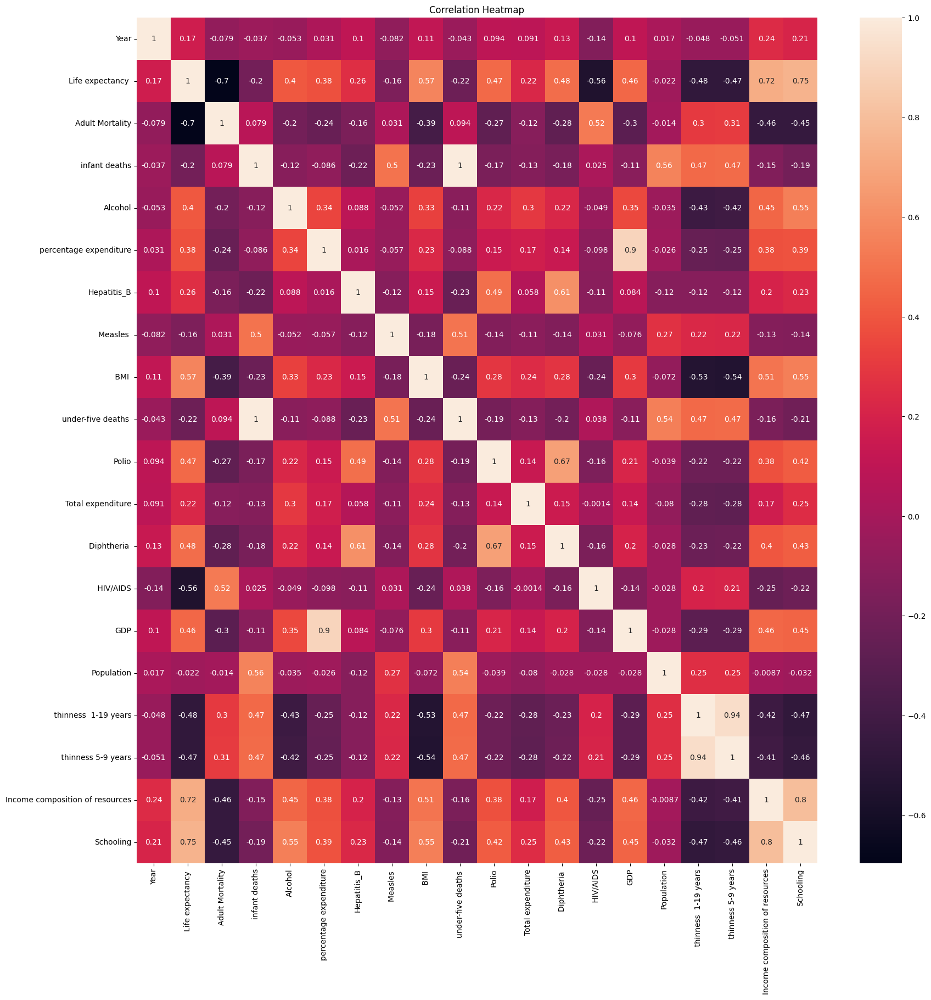

In [56]:
plt.figure(figsize=(20,20))
ax=plt.subplot()
sns.heatmap(corr_matrix,annot=True,ax=ax)
plt.title("Correlation Heatmap")
plt.show()

In [57]:
from pyspark.ml import Pipeline
from pyspark.ml.feature import OneHotEncoder,StringIndexer,VectorAssembler

In [58]:
from pyspark.ml.feature import StringIndexer
from pyspark.ml.linalg import Vector
from pyspark.ml.feature import VectorAssembler

In [59]:
indexers=[StringIndexer(inputCol=column,outputCol=column+"_index").
          fit(df) for column in list(set(df.columns)) ]
pipeline=Pipeline(stages=indexers)
df_r=pipeline.fit(df).transform(df)
df_r.show

<bound method DataFrame.show of DataFrame[Country: string, Year: int, Status: string, Life expectancy : double, Adult Mortality: int, infant deaths: int, Alcohol: double, percentage expenditure: double, Hepatitis_B: int, Measles : int,  BMI : double, under-five deaths : int, Polio: int, Total expenditure: double, Diphtheria : int,  HIV/AIDS: double, GDP: double, Population: double,  thinness  1-19 years: double,  thinness 5-9 years: double, Income composition of resources: double, Schooling: double, Measles _index: double, Schooling_index: double, Life expectancy _index: double, Total expenditure_index: double, Diphtheria _index: double, Population_index: double, Alcohol_index: double,  thinness 5-9 years_index: double, Country_index: double, Hepatitis_B_index: double, Status_index: double, Polio_index: double,  HIV/AIDS_index: double, infant deaths_index: double, Income composition of resources_index: double, Year_index: double,  thinness  1-19 years_index: double,  BMI _index: double, under-five deaths _index: double, GDP_index: double, percentage expenditure_index: double, Adult Mortality_index: double]>

In [60]:
df.show()  # Display the first 20 rows of the DataFrame
df.show(5)  # Display the first 5 rows of the DataFrame
df.show(truncate=False)  # Display long values in full
df.show(vertical=True)  # Display the DataFrame vertically

+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+-----------+-----------+---------------------+-------------------+-------------------------------+---------+
|    Country|Year|    Status|Life expectancy |Adult Mortality|infant deaths|Alcohol|percentage expenditure|Hepatitis_B|Measles | BMI |under-five deaths |Polio|Total expenditure|Diphtheria | HIV/AIDS|        GDP| Population| thinness  1-19 years| thinness 5-9 years|Income composition of resources|Schooling|
+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+-----------+-----------+---------------------+-------------------+-------------------------------+---------+
|Afghanistan|2015|Developing|            65.0|            263|           62|

In [61]:
# Fix typo in input column name
assembler = VectorAssembler(inputCols=[ 'Year', 'Adult Mortality', 'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis_B','Measles ', 'under-five deaths ', 'Polio', 'Total expenditure', 'Diphtheria ',' HIV/AIDS', 'GDP', 'Population', ' thinness  1-19 years', ' thinness 5-9 years', 'Income composition of resources', 'Schooling'], outputCol='features')

# Transform the DataFrame
output = assembler.transform(df)
output.show(3)


+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+----------+-----------+---------------------+-------------------+-------------------------------+---------+--------------------+
|    Country|Year|    Status|Life expectancy |Adult Mortality|infant deaths|Alcohol|percentage expenditure|Hepatitis_B|Measles | BMI |under-five deaths |Polio|Total expenditure|Diphtheria | HIV/AIDS|       GDP| Population| thinness  1-19 years| thinness 5-9 years|Income composition of resources|Schooling|            features|
+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+----------+-----------+---------------------+-------------------+-------------------------------+---------+--------------------+
|Afghanistan|201

In [62]:
final_data = output.select(['features' , 'Life expectancy '])
final_data.show(3)

+--------------------+----------------+
|            features|Life expectancy |
+--------------------+----------------+
|[2015.0,263.0,62....|            65.0|
|[2014.0,271.0,64....|            59.9|
|[2013.0,268.0,66....|            59.9|
+--------------------+----------------+
only showing top 3 rows



In [63]:
final_data = output.select(['features' , 'Life expectancy '])
final_data = final_data.dropna() # Remove rows with null values

In [64]:
train, test=final_data.randomSplit([0.7,0.3])

In [65]:
a=df.describe(['Life expectancy '])
a.show()

+-------+-----------------+
|summary| Life expectancy |
+-------+-----------------+
|  count|           234240|
|   mean|69.22493169398828|
| stddev|9.522261331334366|
|    min|             36.3|
|    max|             89.0|
+-------+-----------------+



In [66]:
final_data = output.select(['features' , 'Life expectancy ']) # Corrected column name
final_data = final_data.dropna() # Remove rows with null values

In [67]:
spark.version

'3.4.0'

In [68]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from datetime import datetime as dt

multi_evaluator = MulticlassClassificationEvaluator(labelCol='Life_Expectancy',metricName='accuracy')

In [69]:
# Set the driver and executor memory to 8g before creating the SparkSession
!pip install pyspark
import pyspark
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName("my_app").config("spark.driver.memory", "8g").config("spark.executor.memory", "8g").getOrCreate()



In [70]:
# Load data into the SparkSession
final_data = spark.read.format("csv").option("header","true").load("/content/Life Expectancy Data.csv")

In [71]:
# Split the final_data DataFrame into train and test DataFrames
train, test = final_data.randomSplit([0.7, 0.3])

In [72]:
# Show descriptive statistics of the train DataFrame
train.describe().show()

+-------+-----------+-----------------+----------+-----------------+------------------+------------------+------------------+----------------------+------------------+------------------+------------------+------------------+------------------+-----------------+-----------------+------------------+------------------+--------------------+---------------------+-------------------+-------------------------------+-----------------+
|summary|    Country|             Year|    Status| Life expectancy |   Adult Mortality|     infant deaths|           Alcohol|percentage expenditure|       Hepatitis_B|          Measles |              BMI |under-five deaths |             Polio|Total expenditure|      Diphtheria |          HIV/AIDS|               GDP|          Population| thinness  1-19 years| thinness 5-9 years|Income composition of resources|        Schooling|
+-------+-----------+-----------------+----------+-----------------+------------------+------------------+------------------+-------------

In [73]:
# Show the first 3 rows of the test DataFrame
test.show(3)

+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+------+----------+---------------------+-------------------+-------------------------------+---------+
|    Country|Year|    Status|Life expectancy |Adult Mortality|infant deaths|Alcohol|percentage expenditure|Hepatitis_B|Measles | BMI |under-five deaths |Polio|Total expenditure|Diphtheria | HIV/AIDS|   GDP|Population| thinness  1-19 years| thinness 5-9 years|Income composition of resources|Schooling|
+-----------+----+----------+----------------+---------------+-------------+-------+----------------------+-----------+--------+-----+------------------+-----+-----------------+-----------+---------+------+----------+---------------------+-------------------+-------------------------------+---------+
|Afghanistan|2000|Developing|            54.8|            321|           88|   0.01|          

In [74]:
# Show descriptive statistics of the test DataFrame
test.describe().show()

+-------+-----------+------------------+----------+-----------------+------------------+------------------+-----------------+----------------------+------------------+------------------+------------------+------------------+------------------+-----------------+------------------+------------------+-----------------+--------------------+---------------------+-------------------+-------------------------------+------------------+
|summary|    Country|              Year|    Status| Life expectancy |   Adult Mortality|     infant deaths|          Alcohol|percentage expenditure|       Hepatitis_B|          Measles |              BMI |under-five deaths |             Polio|Total expenditure|       Diphtheria |          HIV/AIDS|              GDP|          Population| thinness  1-19 years| thinness 5-9 years|Income composition of resources|         Schooling|
+-------+-----------+------------------+----------+-----------------+------------------+------------------+-----------------+-----------

#**Machine Learning Algorithms using python**

In [75]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from datetime import datetime as dt

multi_evaluator=MulticlassClassificationEvaluator(labelCol='Life expectancy',metricName='accuracy')

In [76]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
import sklearn.metrics as metrics
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor


In [77]:
import pandas as pd

life = pd.read_csv("/content/Life Expectancy Data.csv")
life.drop(["Country", "Status"], axis=1, inplace=True)

In [78]:
!pip install pycountry
import pycountry

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.2/6.2 MB 15.1 MB/s eta 0:00:00


In [79]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as pt
import plotly.express as px
import plotly.express as plt
import pycountry
from sklearn.linear_model import LinearRegression
import sklearn
import sklearn.metrics as sm
import math

# **Handling the Data**

In [80]:
data = pd.read_csv("/content/Life Expectancy Data.csv")
data.head()

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis_B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


##The Independent variables indicate

1. Status: Is the Country Developing or already developed.
2. Adult Mortality Rate: Indicates probability of death between the age of 15 to 60 per 1000 (includes both gender).
3. Infant Death: Number of Infant Death.
4. Expenditure: Percentage of Expenditure on Healthcare wrt GDP
5. BMI: Average BMI of total population.
6. Total Expenditure: Percentage of expenditure on Healthcare by Government wrt other expenditure
7. Thinness (Age 1 to 19): Adoption of Thinness among childrens and Adults from age 1 to 19
8. Thinness (Age 5 to 9): Adoption of Thinness among childrens and Adults from age 5 to 9
9. Income Composition: Human Development Index based on the income composition of resources:\

In [81]:
data.shape

(235040, 22)

In [82]:
data.describe().describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis_B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000,8.000000e+00,8.000000,8.000000,8.000000,8.000000
mean,30886.391473,29331.868399,29462.383446,29626.651329,27444.858693,32219.646847,23909.000661,57685.742176,29073.207734,29721.806790,29249.496784,27125.489194,29249.379623,29387.314879,43534.240023,1.721000e+08,29046.144893,29046.259804,27710.466927,27759.093889
std,82493.493056,82795.392040,82742.945164,83001.849516,77610.077293,82221.928225,67434.156545,102665.690097,82124.109956,82965.563863,82537.755186,76704.725824,82537.802612,83096.235073,74660.047579,4.537251e+08,82135.041252,82134.994854,78375.526960,78485.178485
min,4.613065,9.522261,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.370000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2003.000000,56.400000,111.703338,2.250000,3.035625,49.853078,64.016206,12.750000,19.855469,3.000000,64.356021,3.819466,64.428225,0.100000,1441.173851,1.923848e+05,2.875000,2.850000,0.422466,8.414581
50%,2007.759360,70.662466,154.398224,26.151974,4.327272,590.047960,86.470231,1390.296120,40.910623,35.017869,87.775094,5.846595,87.662042,1.271052,6700.678725,4.404916e+06,4.629574,4.689216,0.652276,12.146396
75%,2012.750000,79.025000,351.750000,538.430011,10.244375,6360.663462,97.500000,61644.758877,63.975000,745.313937,97.500000,10.019375,97.500000,16.457698,40493.689977,2.481476e+07,12.325000,12.550000,0.821250,15.900000
max,235040.000000,234240.000000,234240.000000,235040.000000,219520.000000,235040.000000,190800.000000,235040.000000,232320.000000,235040.000000,233520.000000,216960.000000,233520.000000,235040.000000,199200.000000,1.293859e+09,232320.000000,232320.000000,221680.000000,222000.000000


In [83]:
data.isnull().sum()

Country                                0
Year                                   0
Status                                 0
Life expectancy                      800
Adult Mortality                      800
infant deaths                          0
Alcohol                            15520
percentage expenditure                 0
Hepatitis_B                        44240
Measles                                0
 BMI                                2720
under-five deaths                      0
Polio                               1520
Total expenditure                  18080
Diphtheria                          1520
 HIV/AIDS                              0
GDP                                35840
Population                         52160
 thinness  1-19 years               2720
 thinness 5-9 years                 2720
Income composition of resources    13360
Schooling                          13040
dtype: int64

In [84]:
data.columns

Index(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis_B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'],
      dtype='object')

In [85]:
data[['Adult Mortality', 'Alcohol', 'Hepatitis_B', ' BMI ', 'Polio', 'Diphtheria ',
     'Population', ' thinness  1-19 years', ' thinness 5-9 years', 'Life expectancy ', 'Total expenditure',
     'Income composition of resources', 'Schooling', 'GDP']] = data[['Adult Mortality', 'Alcohol', 'Hepatitis_B', ' BMI ', 'Polio', 'Diphtheria ',
     'Population', ' thinness  1-19 years', ' thinness 5-9 years', 'Life expectancy ', 'Total expenditure',
     'Income composition of resources', 'Schooling', 'GDP']].transform(lambda x: x.fillna(x.mean()))

In [86]:
data[['Adult Mortality', 'Alcohol', 'Hepatitis_B', ' BMI ', 'Polio', 'Diphtheria ',
     'Population', ' thinness  1-19 years', ' thinness 5-9 years', 'Life expectancy ', 'Total expenditure',
     'Income composition of resources', 'Schooling', 'GDP']].transform(lambda x: x.fillna(x.mean()))

,Adult Mortality,Alcohol,Hepatitis_B,BMI,Polio,Diphtheria,Population,thinness 1-19 years,thinness 5-9 years,Life expectancy,Total expenditure,Income composition of resources,Schooling,GDP
0,263.0,0.01,65.0,19.1,6.0,65.0,33736494.0,17.2,17.3,65.0,8.16,0.479,10.1,584.259210
1,271.0,0.01,62.0,18.6,58.0,62.0,327582.0,17.5,17.5,59.9,8.18,0.476,10.0,612.696514
2,268.0,0.01,64.0,18.1,62.0,64.0,31731688.0,17.7,17.7,59.9,8.13,0.470,9.9,631.744976
3,272.0,0.01,67.0,17.6,67.0,67.0,3696958.0,17.9,18.0,59.5,8.52,0.463,9.8,669.959000
4,275.0,0.01,68.0,17.2,68.0,68.0,2978599.0,18.2,18.2,59.2,7.87,0.454,9.5,63.537231
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235035,723.0,4.36,68.0,27.1,67.0,65.0,12777511.0,9.4,9.4,44.3,7.13,0.407,9.2,454.366654
235036,715.0,4.06,7.0,26.7,7.0,68.0,12633897.0,9.8,9.9,44.5,6.52,0.418,9.5,453.351155
235037,73.0,4.43,73.0,26.3,73.0,71.0,125525.0,1.2,1.3,44.8,6.53,0.427,10.0,57.348340
235038,686.0,1.72,76.0,25.9,76.0,75.0,12366165.0,1.6,1.7,45.3,6.16,0.427,9.8,548.587312


In [87]:
data.isnull().sum()

Country                            0
Year                               0
Status                             0
Life expectancy                    0
Adult Mortality                    0
infant deaths                      0
Alcohol                            0
percentage expenditure             0
Hepatitis_B                        0
Measles                            0
 BMI                               0
under-five deaths                  0
Polio                              0
Total expenditure                  0
Diphtheria                         0
 HIV/AIDS                          0
GDP                                0
Population                         0
 thinness  1-19 years              0
 thinness 5-9 years                0
Income composition of resources    0
Schooling                          0
dtype: int64

In [88]:
data

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis_B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235035,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
235036,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
235037,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
235038,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


## **Detecting And Removing Outliers**

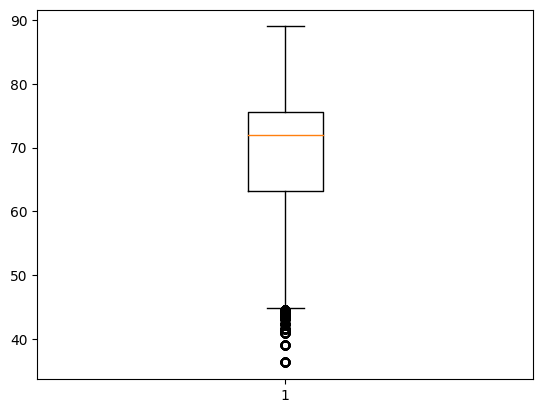

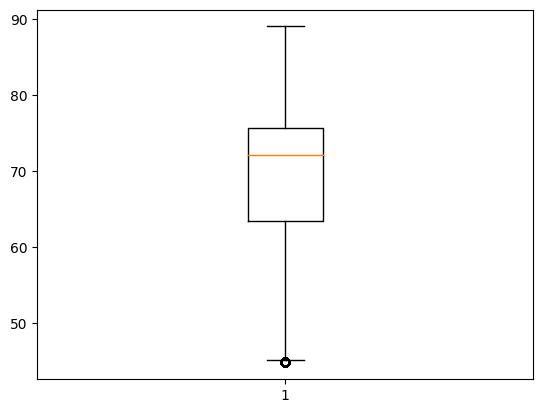

In [89]:
import matplotlib.pyplot as plt
import numpy as np

plt.boxplot(data['Life expectancy '])
plt.show()

q1, q3 = np.percentile(data['Life expectancy '], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Life expectancy '][(data['Life expectancy '] < lower_bound) | (data['Life expectancy '] > upper_bound)]

# remove outliers from the data
data1 = data['Life expectancy '][(data['Life expectancy '] >= lower_bound) & (data['Life expectancy '] <= upper_bound)]
data['Life expectancy '] = data1
# plt.figure()
plt.boxplot(data1)
plt.show()

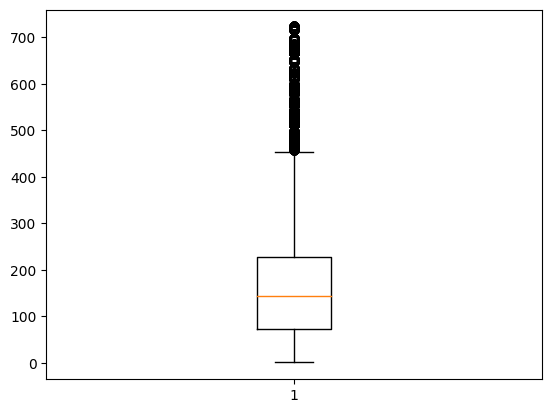

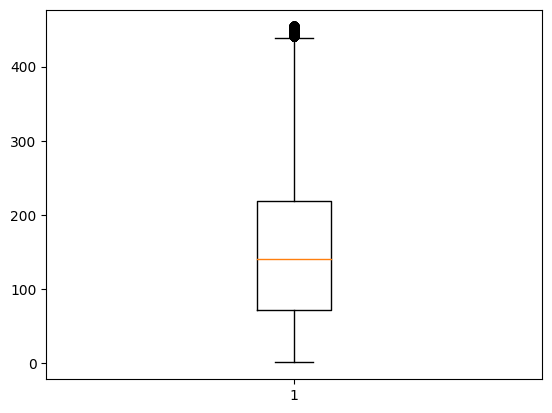

In [90]:
plt.boxplot(data['Adult Mortality'])
plt.show()

q1, q3 = np.percentile(data['Adult Mortality'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Adult Mortality'][(data['Adult Mortality'] < lower_bound) | (data['Adult Mortality'] > upper_bound)]

# remove outliers from the data
data1 = data['Adult Mortality'][(data['Adult Mortality'] >= lower_bound) & (data['Adult Mortality'] <= upper_bound)]
data['Adult Mortality']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

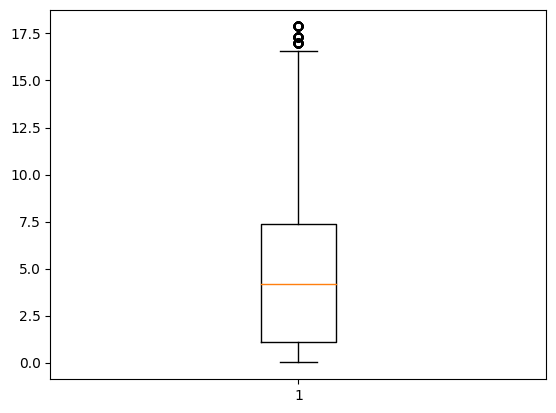

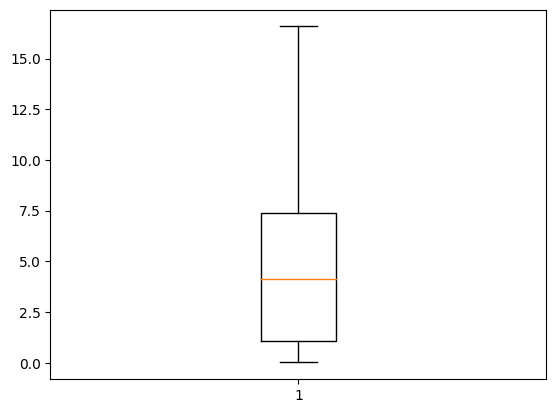

In [91]:
plt.boxplot(data['Alcohol'])
plt.show()

q1, q3 = np.percentile(data['Alcohol'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Alcohol'][(data['Alcohol'] < lower_bound) | (data['Alcohol'] > upper_bound)]

# remove outliers from the data
data1 = data['Alcohol'][(data['Alcohol'] >= lower_bound) & (data['Alcohol'] <= upper_bound)]
data['Alcohol']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

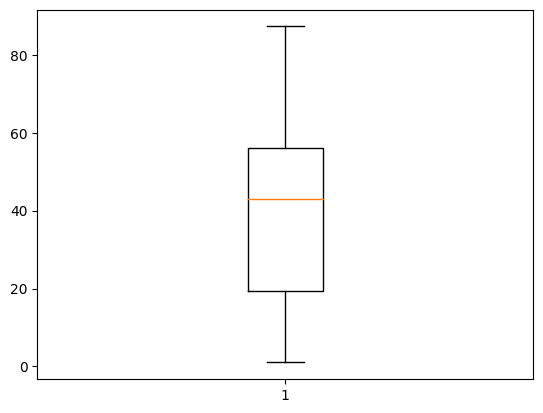

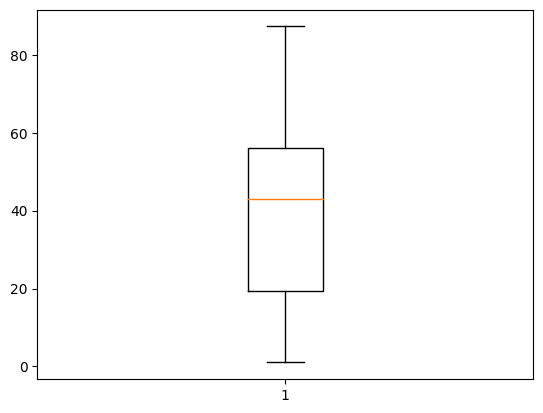

In [92]:
plt.boxplot(data[' BMI '])
plt.show()

q1, q3 = np.percentile(data[' BMI '], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data[' BMI '][(data[' BMI '] < lower_bound) | (data[' BMI '] > upper_bound)]

# remove outliers from the data
data1 = data[' BMI '][(data[' BMI '] >= lower_bound) & (data[' BMI '] <= upper_bound)]
data[' BMI ']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

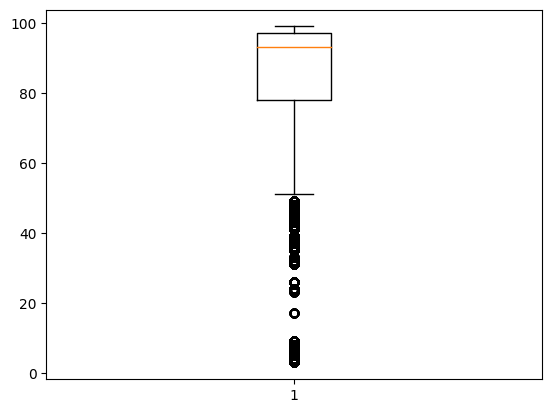

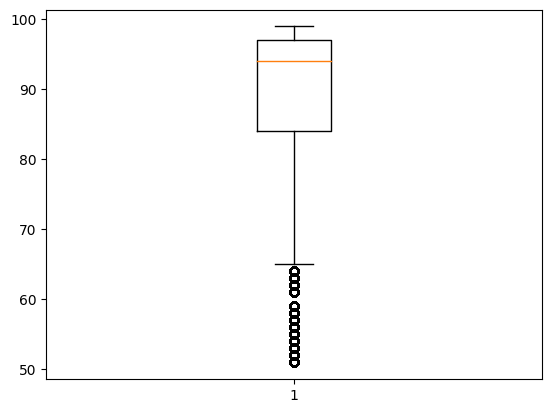

In [93]:
plt.boxplot(data['Polio'])
plt.show()

q1, q3 = np.percentile(data['Polio'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Polio'][(data['Polio'] < lower_bound) | (data['Polio'] > upper_bound)]

# remove outliers from the data
data1 = data['Polio'][(data['Polio'] >= lower_bound) & (data['Polio'] <= upper_bound)]
data['Polio']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

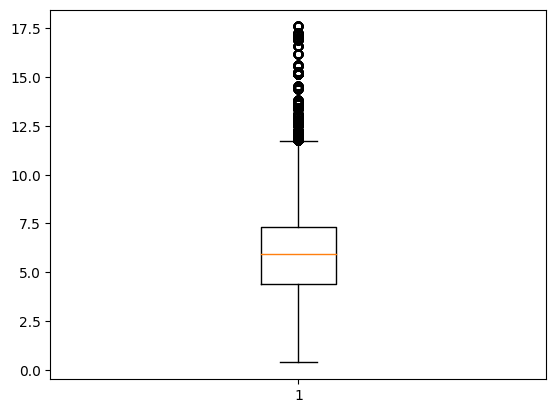

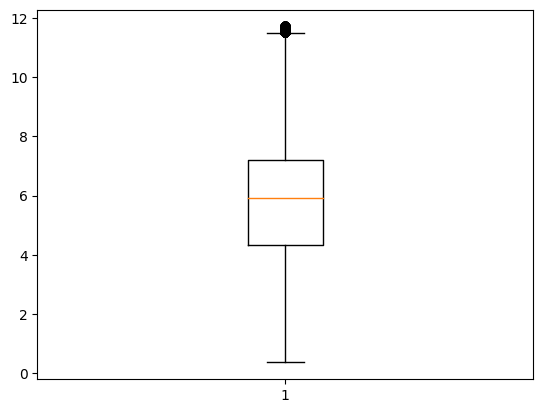

In [94]:
plt.boxplot(data['Total expenditure'])
plt.show()

q1, q3 = np.percentile(data['Total expenditure'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Total expenditure'][(data['Total expenditure'] < lower_bound) | (data['Total expenditure'] > upper_bound)]

# remove outliers from the data
data1 = data['Total expenditure'][(data['Total expenditure'] >= lower_bound) & (data['Total expenditure'] <= upper_bound)]
data['Total expenditure']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

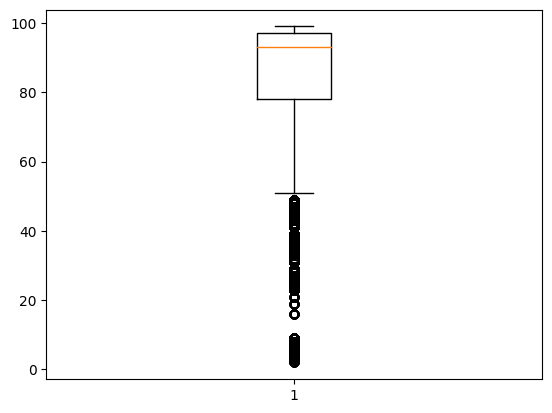

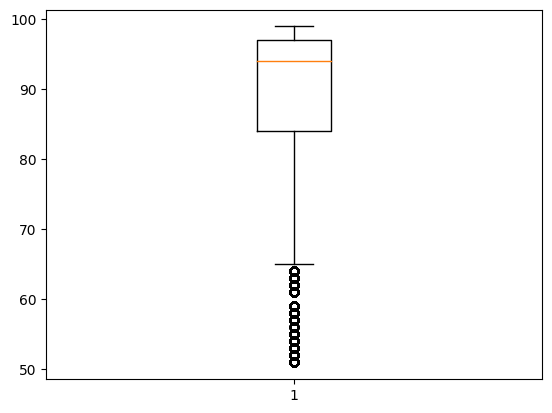

In [95]:
plt.boxplot(data['Diphtheria '])
plt.show()

q1, q3 = np.percentile(data['Diphtheria '], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Diphtheria '][(data['Diphtheria '] < lower_bound) | (data['Diphtheria '] > upper_bound)]

# remove outliers from the data
data1 = data['Diphtheria '][(data['Diphtheria '] >= lower_bound) & (data['Diphtheria '] <= upper_bound)]
data['Diphtheria ']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

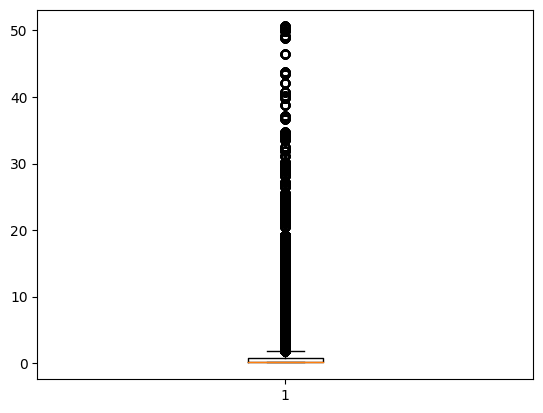

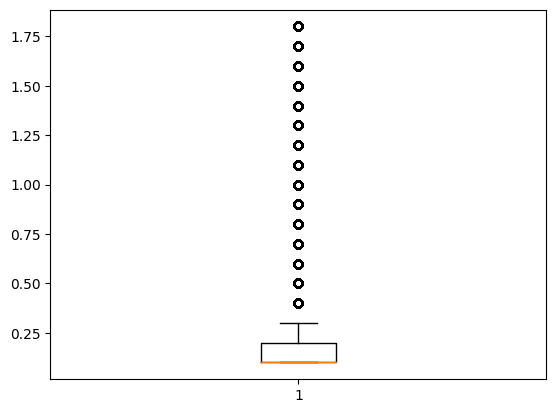

In [96]:
plt.boxplot(data[' HIV/AIDS'])
plt.show()

q1, q3 = np.percentile(data[' HIV/AIDS'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data[' HIV/AIDS'][(data[' HIV/AIDS'] < lower_bound) | (data[' HIV/AIDS'] > upper_bound)]

# remove outliers from the data
data1 = data[' HIV/AIDS'][(data[' HIV/AIDS'] >= lower_bound) & (data[' HIV/AIDS'] <= upper_bound)]
data[' HIV/AIDS']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

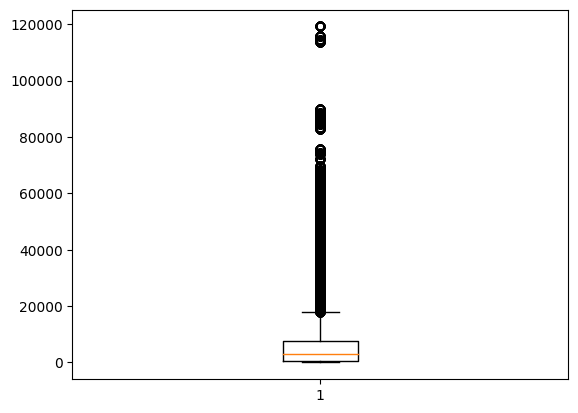

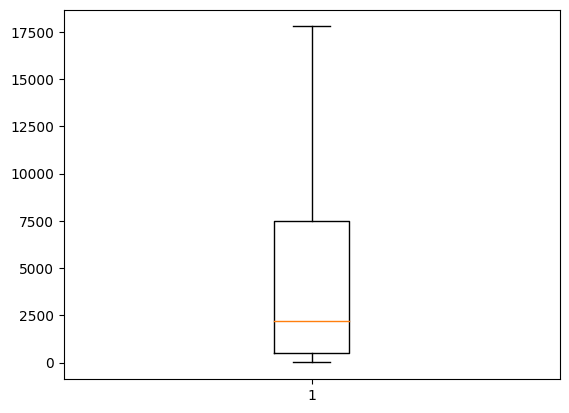

In [97]:
plt.boxplot(data['GDP'])
plt.show()

q1, q3 = np.percentile(data['GDP'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['GDP'][(data['GDP'] < lower_bound) | (data['GDP'] > upper_bound)]

# remove outliers from the data
data1 = data['GDP'][(data['GDP'] >= lower_bound) & (data['GDP'] <= upper_bound)]
data['GDP']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

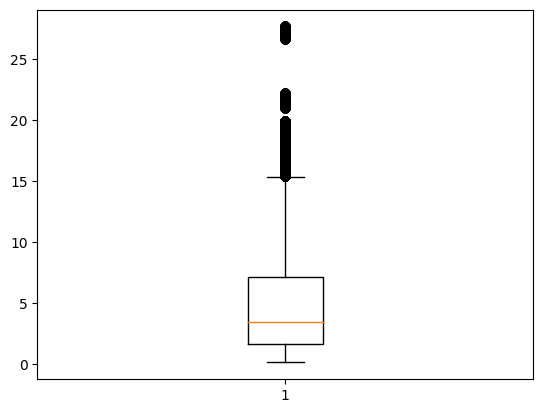

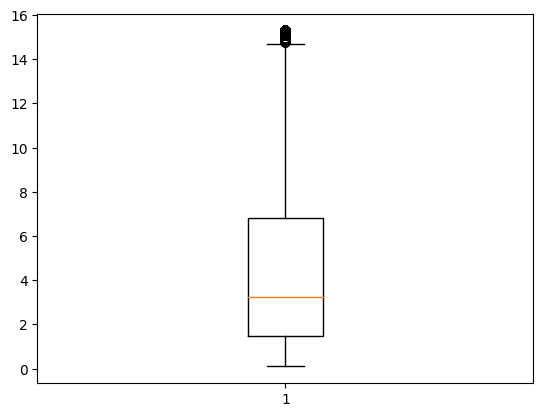

In [98]:
plt.boxplot(data[' thinness  1-19 years'])
plt.show()

q1, q3 = np.percentile(data[' thinness  1-19 years'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data[' thinness  1-19 years'][(data[' thinness  1-19 years'] < lower_bound) | (data[' thinness  1-19 years'] > upper_bound)]

# remove outliers from the data
data1 = data[' thinness  1-19 years'][(data[' thinness  1-19 years'] >= lower_bound) & (data[' thinness  1-19 years'] <= upper_bound)]
data[' thinness  1-19 years']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

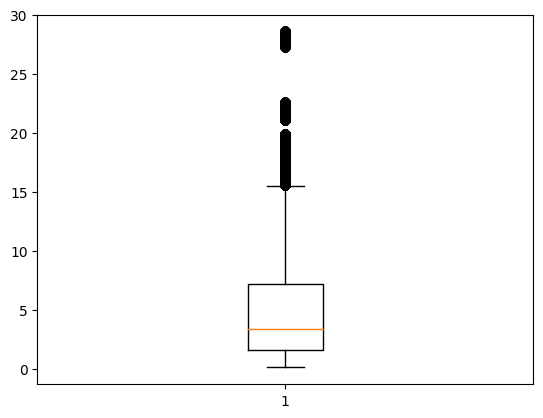

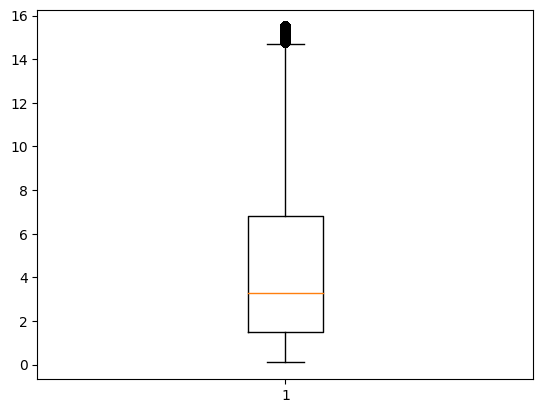

In [99]:
plt.boxplot(data[' thinness 5-9 years'])
plt.show()

q1, q3 = np.percentile(data[' thinness 5-9 years'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data[' thinness 5-9 years'][(data[' thinness 5-9 years'] < lower_bound) | (data[' thinness 5-9 years'] > upper_bound)]

# remove outliers from the data
data1 = data[' thinness 5-9 years'][(data[' thinness 5-9 years'] >= lower_bound) & (data[' thinness 5-9 years'] <= upper_bound)]
data[' thinness 5-9 years']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

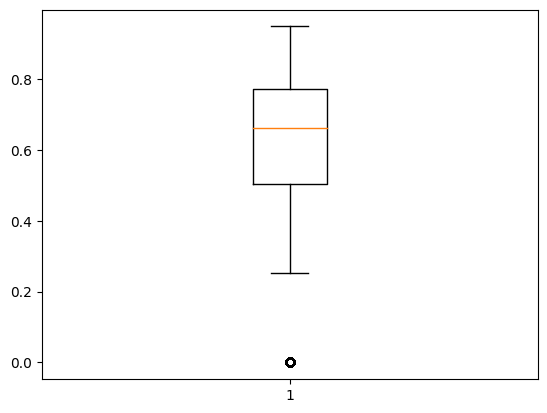

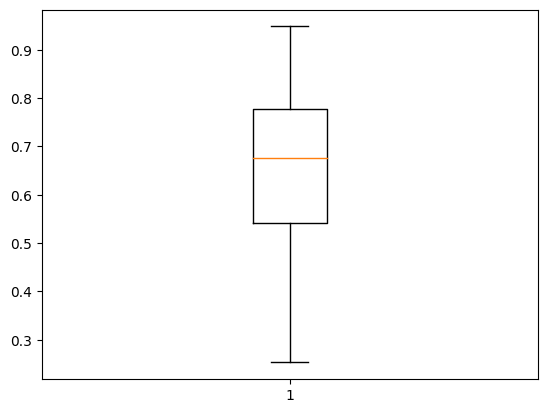

In [100]:
plt.boxplot(data['Income composition of resources'])
plt.show()

q1, q3 = np.percentile(data['Income composition of resources'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Income composition of resources'][(data['Income composition of resources'] < lower_bound) | (data['Income composition of resources'] > upper_bound)]

# remove outliers from the data
data1 = data['Income composition of resources'][(data['Income composition of resources'] >= lower_bound) & (data['Income composition of resources'] <= upper_bound)]
data['Income composition of resources']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

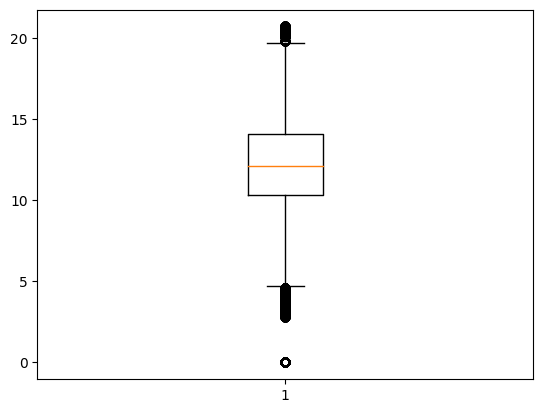

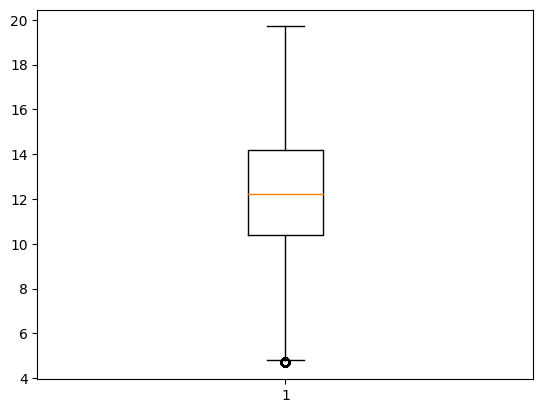

In [101]:
plt.boxplot(data['Schooling'])
plt.show()

q1, q3 = np.percentile(data['Schooling'], [25, 75])
iqr = q3 - q1
lower_bound = q1 - (1.5 * iqr)
upper_bound = q3 + (1.5 * iqr)
outliers = data['Schooling'][(data['Schooling'] < lower_bound) | (data['Schooling'] > upper_bound)]

# remove outliers from the data
data1 = data['Schooling'][(data['Schooling'] >= lower_bound) & (data['Schooling'] <= upper_bound)]
data['Schooling']= data1
# plt.figure()
plt.boxplot(data1)
plt.show()

Box plots were used to detect outliers for each variable

In [102]:
data

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis_B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,NaN,8.16,65.0,0.1,584.259210,33736494.0,NaN,NaN,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,NaN,NaN,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,NaN,NaN,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,NaN,NaN,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,NaN,NaN,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235035,Zimbabwe,2004,Developing,NaN,NaN,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,NaN,454.366654,12777511.0,9.4,9.4,0.407,9.2
235036,Zimbabwe,2003,Developing,NaN,NaN,26,4.06,0.000000,7.0,998,...,NaN,6.52,68.0,NaN,453.351155,12633897.0,9.8,9.9,0.418,9.5
235037,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,NaN,57.348340,125525.0,1.2,1.3,0.427,10.0
235038,Zimbabwe,2001,Developing,45.3,NaN,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,NaN,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [103]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 235040 entries, 0 to 235039
Data columns (total 22 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   Country                          235040 non-null  object 
 1   Year                             235040 non-null  int64  
 2   Status                           235040 non-null  object 
 3   Life expectancy                  233680 non-null  float64
 4   Adult Mortality                  228160 non-null  float64
 5   infant deaths                    235040 non-null  int64  
 6   Alcohol                          234800 non-null  float64
 7   percentage expenditure           235040 non-null  float64
 8   Hepatitis_B                      235040 non-null  float64
 9   Measles                          235040 non-null  int64  
 10   BMI                             235040 non-null  float64
 11  under-five deaths                235040 non-null  int64  
 12  Po

In [104]:
data[['Life expectancy ','Adult Mortality','Alcohol','percentage expenditure','Polio','Total expenditure','Diphtheria ',
     ' HIV/AIDS','GDP',' thinness  1-19 years',' thinness 5-9 years','Income composition of resources','Schooling']]= data[['Life expectancy ','Adult Mortality','Alcohol','percentage expenditure','Polio','Total expenditure','Diphtheria ',
     ' HIV/AIDS','GDP',' thinness  1-19 years',' thinness 5-9 years','Income composition of resources','Schooling']].transform(lambda x: x.fillna(x.mean()))

Null values were removed with mean values for each country

In [105]:
data.isnull().sum()

Country                            0
Year                               0
Status                             0
Life expectancy                    0
Adult Mortality                    0
infant deaths                      0
Alcohol                            0
percentage expenditure             0
Hepatitis_B                        0
Measles                            0
 BMI                               0
under-five deaths                  0
Polio                              0
Total expenditure                  0
Diphtheria                         0
 HIV/AIDS                          0
GDP                                0
Population                         0
 thinness  1-19 years              0
 thinness 5-9 years                0
Income composition of resources    0
Schooling                          0
dtype: int64

# **Performing Exploratory Data Analysis on cleaned data**

# **1) Pair Plot**

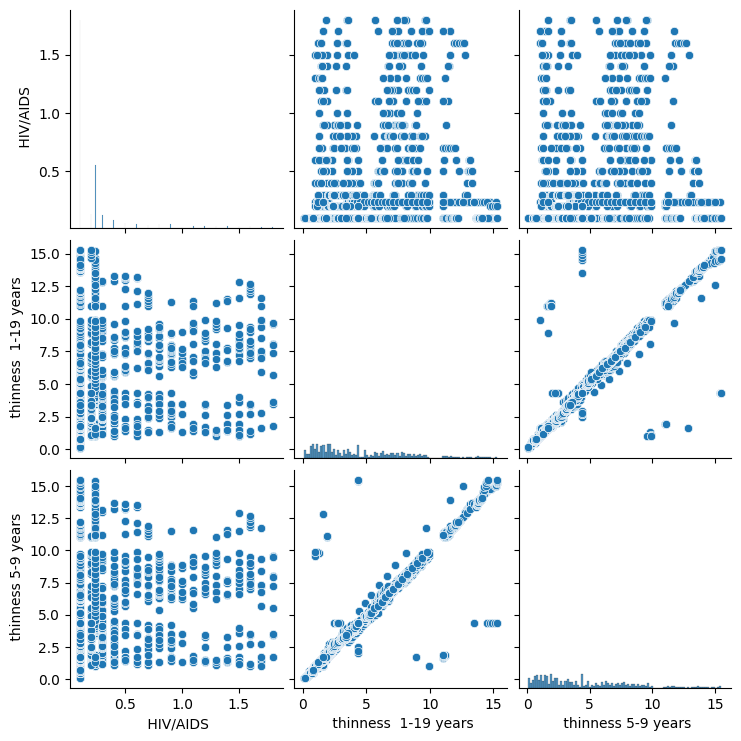

In [106]:
sns.pairplot(data[[' HIV/AIDS',' thinness  1-19 years',' thinness 5-9 years']])

From the above pairplot, we can see that people do get thin with an HIV/ AIDS disease

Moreover thinness for age group 5-9 have a positive correlation with thinness for age group 1-19

# **2) Bar Plot**

<Axes: title={'center': 'Average Life Expectancy'}, xlabel='Status', ylabel='Life Expectancy'>

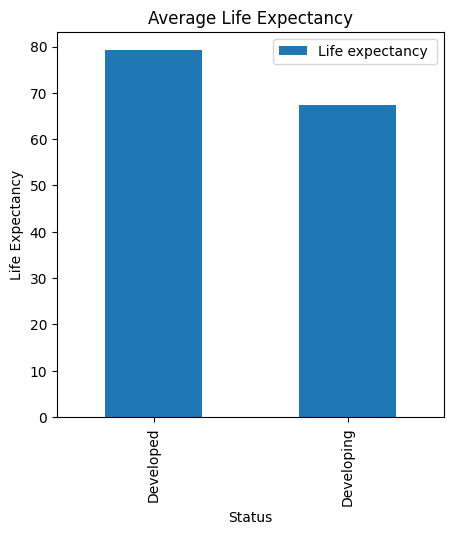

In [107]:
import plotly.express as plt
data_1 = data.groupby(['Status'])[['Life expectancy ']].mean()
data_1.plot(kind='bar', title='Average Life Expectancy', ylabel='Life Expectancy', xlabel='Status', figsize=(5, 5))

Average Life Expectancy for Developed Country is greater than country which is still Developing

# **3) Bubble Chart**

In [108]:
px.scatter(data,x='Life expectancy ',y='percentage expenditure',color='Country',size='Year',title='Life Expectancy VS Percentage Expenditure', width = None, height = None)

We can see from the above graph that as the age increases, percentage expenditure for Health Sector increases. We can also depict that higher life expectancy leads to higher expenditure on healthcare

# **4) Animeted Bubble Chart**

In [109]:
grouped = data.groupby('Country')
px.scatter(data.sort_values(by='Year'),y='Schooling',x='Life expectancy ',animation_frame='Year',animation_group='Country',color='Country',size='Life expectancy ',title='Life expectancy VS Schooling of countries in every year', height = None, width = None)

As the years pass on we can see that Life expectany for each and every country has increased as the number of years for Schooling has increased.

# **5) Choropleth Map Chart**

we used pycountry library to get country code from country code and for that we created a custom function which convert country name into 3 letter country code and if country name is not defined then it shows None in country code.

In [110]:
import pycountry

def get_country_code(country_name):
    try:
        country_code = pycountry.countries.search_fuzzy(country_name)[0].alpha_3
    except LookupError:
        # Handle the case where the country name is not found
        country_code = None
    return country_code
num_rows = 10000

# Apply the function to the limited number of rows
data_subset = data.head(num_rows)
data_subset['Country Code'] = data_subset['Country'].apply(get_country_code)

# Update the 'Country Code' column in the original DataFrame with the processed subset
data.loc[data_subset.index, 'Country Code'] = data_subset['Country Code']

SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Belize', parent_code=None, type='District')
SubdivisionHierarchy(code='BZ-BZ', country_code='BZ', name='Beli

<ipython-input-110-66b5a282ba86>:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [111]:
import plotly.express as px
px.choropleth(data,
              locations='Country Code',
              color="Life expectancy ",
              hover_name="Country",
              animation_frame="Year",
              color_continuous_scale='Plasma',
              height=600
)

The lowest Life Expectancy we can see is in the African region from the year 2000 to 2015

In [112]:
data_1 = data.iloc[:,3:-1]
data_1

,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis_B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,65.000000,263.000000,62,0.01,71.279624,65.0,1154,19.1,83,89.044172,8.16,65.0,0.100000,584.259210,33736494.0,4.330215,4.344872,0.479,10.1
1,59.900000,271.000000,64,0.01,73.523582,62.0,492,18.6,86,58.000000,8.18,62.0,0.100000,612.696514,327582.0,4.330215,4.344872,0.476,10.0
2,59.900000,268.000000,66,0.01,73.219243,64.0,430,18.1,89,62.000000,8.13,64.0,0.100000,631.744976,31731688.0,4.330215,4.344872,0.470,9.9
3,59.500000,272.000000,69,0.01,78.184215,67.0,2787,17.6,93,67.000000,8.52,67.0,0.100000,669.959000,3696958.0,4.330215,4.344872,0.463,9.8
4,59.200000,275.000000,71,0.01,7.097109,68.0,3013,17.2,97,68.000000,7.87,68.0,0.100000,63.537231,2978599.0,4.330215,4.344872,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235035,69.378175,153.144448,27,4.36,0.000000,68.0,31,27.1,42,67.000000,7.13,65.0,0.239023,454.366654,12777511.0,9.400000,9.400000,0.407,9.2
235036,69.378175,153.144448,26,4.06,0.000000,7.0,998,26.7,41,89.044172,6.52,68.0,0.239023,453.351155,12633897.0,9.800000,9.900000,0.418,9.5
235037,44.800000,73.000000,25,4.43,0.000000,73.0,304,26.3,40,73.000000,6.53,71.0,0.239023,57.348340,125525.0,1.200000,1.300000,0.427,10.0
235038,45.300000,153.144448,25,1.72,0.000000,76.0,529,25.9,39,76.000000,6.16,75.0,0.239023,548.587312,12366165.0,1.600000,1.700000,0.427,9.8


# **6) Heat map for finding co-relation between columns and on targeted variable**

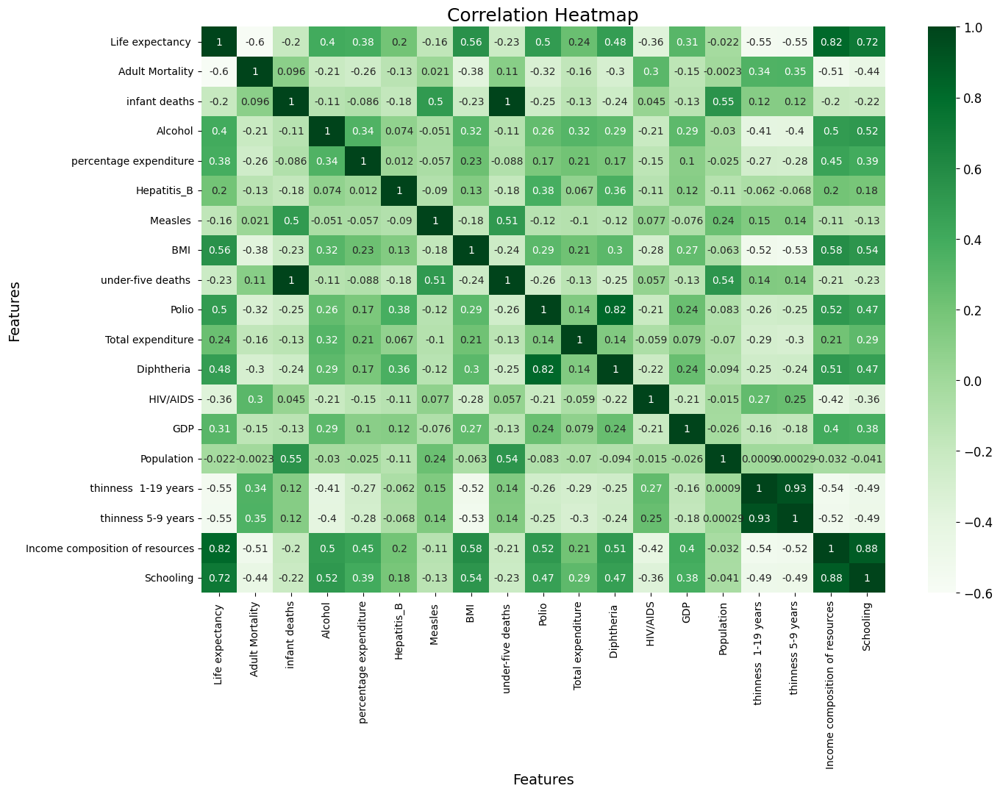

In [113]:
import matplotlib.pyplot as plt

plt.ion()
fig, ax = plt.subplots(figsize=(15, 10))
sns.heatmap(data_1.corr(), annot=True, cmap='Greens', ax=ax)

cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=12)

ax.set_title('Correlation Heatmap', fontsize=18)
ax.set_xlabel('Features', fontsize=14)
ax.set_ylabel('Features', fontsize=14)

plt.show()

In [114]:
X = data.iloc[:, 4:-1].values

# **Performing PCA (Pricipal Componant Analysis)**

In [115]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
sc.fit(X)
X_Scaled = sc.transform(X)
X_Scaled

array([[ 1.06116523e+00,  2.68823775e-01, -1.17605314e+00, ...,
        -5.20267948e-16, -1.15355659e+00, -7.28139667e-01],
       [ 1.13844236e+00,  2.85786378e-01, -1.17605314e+00, ...,
        -5.20267948e-16, -1.17304186e+00, -7.63229847e-01],
       [ 1.10946343e+00,  3.02748982e-01, -1.17605314e+00, ...,
        -5.20267948e-16, -1.21201242e+00, -7.98320028e-01],
       ...,
       [-7.74166613e-01, -4.49843850e-02, -4.10328969e-02, ...,
        -8.91796693e-01, -1.49130136e+00, -7.63229847e-01],
       [ 2.74543517e-16, -4.49843850e-02, -7.36938974e-01, ...,
        -7.74642766e-01, -1.49130136e+00, -8.33410208e-01],
       [ 2.74543517e-16, -5.34656867e-02, -7.47210651e-01, ...,
         2.00776300e+00, -1.44583572e+00, -8.33410208e-01]])

In [116]:
cov_m = np.cov(X_Scaled.T)
cov_m.shape

(18, 18)

In [117]:
eigenvalues, eigenvectors = np.linalg.eig(cov_m)

In [118]:
eigenvectors = eigenvectors.T

In [119]:
eigenvectors[0, :]

array([-0.23272458, -0.1832139 ,  0.24788545,  0.19012815,  0.13002504,
       -0.12405638,  0.28752372, -0.18965421,  0.26774537,  0.15968217,
        0.26756562, -0.18588517,  0.17952095, -0.07798904, -0.29138565,
       -0.29014397,  0.36275007,  0.34845875])

In [120]:
eigenvalues = np.cumsum(eigenvalues)
eigenvalues /= eigenvalues.max()
eigenvalues

array([0.3135822 , 0.45521922, 0.54430002, 0.54445983, 0.5483529 ,
       0.55421663, 0.56392982, 0.6214206 , 0.67924296, 0.72954981,
       0.75254721, 0.77889931, 0.8079093 , 0.83797971, 0.88146071,
       0.92326563, 0.96115533, 1.        ])

In [121]:
p = eigenvectors[0:16, :]
p.shape


(16, 18)

In [122]:
data_new = np.dot(p, X_Scaled.T)
data_new.shape

(16, 235040)

In [123]:
data_new = data_new.T
data_new.shape

(235040, 16)

In [124]:
df_new = pd.DataFrame(data_new, columns = ['PC1', 'PC2', 'PC3',
                                           'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10', 'PC11', 'PC12',
                                           'PC13','PC14','PC15','PC16'])
df_new.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16
0,-2.286370,-0.042731,-1.497801,-0.003997,-0.026895,-0.289128,-1.626194,0.182391,-0.519087,-0.044363,-0.654123,0.676471,0.604136,0.465998,-1.113292,0.725337
1,-3.149143,0.055790,-3.086355,0.013248,-0.012212,-0.023551,0.196758,-0.290839,0.144349,-0.037064,-0.982326,0.321049,0.488224,0.272986,-1.770419,0.196903
2,-3.066671,-0.158423,-2.725854,0.004957,-0.014437,-0.057468,0.084211,-0.232555,-0.050770,-0.106609,-0.859776,0.620784,0.379629,0.263958,-1.633080,0.552045
3,-2.854098,0.028090,-2.373976,0.011087,-0.019984,-0.095401,-0.049221,0.094097,-0.162096,-0.079176,-0.798177,0.428948,0.606399,0.452000,-1.684890,0.218877
4,-2.962126,0.060434,-2.220303,0.006117,-0.012925,-0.097953,-0.050805,0.003515,-0.318902,0.022304,-0.711807,0.393570,0.540215,0.398402,-1.507658,0.218670


Upper table is final result of PCA

In [125]:
X = df_new
y = data['Life expectancy ']

# **Models Implementation**

##Linear Regression

In [126]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.3  ,random_state= 42)


In [127]:
lrregressor = LinearRegression()
lrregressor.fit(X_train, y_train)
y_pred = lrregressor.predict(X_test)
lr_mse = sm.mean_squared_error(y_test, y_pred)
lr_rmse = math.sqrt(lr_mse)
lr_r2 = sm.r2_score(y_test, y_pred)
print("Root Mean squared error =", lr_mse)
print("R2 Score =", lr_r2)

Root Mean squared error = 22.66592782962712
R2 Score = 0.737240018680543


##Decision Tree Regression

In [128]:
from sklearn.tree import DecisionTreeRegressor
dtregressor = DecisionTreeRegressor(random_state = 0)
dtregressor.fit(X_train, y_train)

y_pred = dtregressor.predict(X_test)

dt_mse = sm.mean_squared_error(y_test, y_pred)
dt_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", dt_mse)
print("R2 Score =", dt_r2)

Mean squared error = 3.603177943655736e-27
R2 Score = 1.0


##Random Forest Regression

In [129]:
from sklearn.ensemble import RandomForestRegressor
rfregressor = RandomForestRegressor(n_estimators = 10, random_state = 0)
rfregressor.fit(X_train, y_train)

y_pred = rfregressor.predict(X_test)

rf_mse = sm.mean_squared_error(y_test, y_pred)
rf_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", rf_mse)
print("R2 Score =", rf_r2)

Mean squared error = 4.135986806964344e-28
R2 Score = 1.0


##Lasso Regression

In [130]:
from sklearn.linear_model import Lasso
lasso = Lasso()
lasso.fit(X_train, y_train)

y_pred = lasso.predict(X_test)

lasso_mse = sm.mean_squared_error(y_test, y_pred)
lasso_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", lasso_mse)
print("R2 Score =", lasso_r2)

Mean squared error = 29.13187447563383
R2 Score = 0.6622820450785737


##Ridge Regression

In [131]:
from sklearn.linear_model import Ridge
ridge = Ridge()
ridge.fit(X_train, y_train)

y_pred = ridge.predict(X_test)

ridge_mse = sm.mean_squared_error(y_test, y_pred)
ridge_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", ridge_mse)
print("R2 Score =", ridge_r2)

Mean squared error = 22.66581577103307
R2 Score = 0.7372413177455669


##Elastic Net Regression

In [132]:
from sklearn.linear_model import ElasticNet
en = ElasticNet()
en.fit(X_train, y_train)

y_pred = en.predict(X_test)

en_mse = sm.mean_squared_error(y_test, y_pred)
en_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", en_mse)
print("R2 Score =", en_r2)

Mean squared error = 28.483586082926575
R2 Score = 0.6697974773713881


##K Neighbour Regression

In [133]:
from sklearn.neighbors import KNeighborsRegressor
kn = KNeighborsRegressor()
kn.fit(X_train, y_train)

y_pred = kn.predict(X_test)

kn_mse = sm.mean_squared_error(y_test, y_pred)
kn_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", kn_mse)
print("R2 Score =", kn_r2)

Mean squared error = 0.0
R2 Score = 1.0


##Gradient Boosting Regression

In [134]:
from sklearn.ensemble import GradientBoostingRegressor
gb = GradientBoostingRegressor()
gb.fit(X_train, y_train)

y_pred = gb.predict(X_test)

gb_mse = sm.mean_squared_error(y_test, y_pred)
gb_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", gb_mse)
print("R2 Score =", gb_r2)

Mean squared error = 10.414917144633256
R2 Score = 0.8792626776658828


##ADA Boosting Regression

In [135]:
from sklearn.ensemble import AdaBoostRegressor
ab = AdaBoostRegressor()
ab.fit(X_train, y_train)

y_pred = ab.predict(X_test)

ab_mse = sm.mean_squared_error(y_test, y_pred)
ab_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", ab_mse)
print("R2 Score =", ab_r2)

Mean squared error = 19.43331626755446
R2 Score = 0.7747148116847368


##Extra Tree Regression

In [136]:
from sklearn.ensemble import ExtraTreesRegressor
et = ExtraTreesRegressor()
et.fit(X_train, y_train)

y_pred = et.predict(X_test)

et_mse = sm.mean_squared_error(y_test, y_pred)
et_r2 = sm.r2_score(y_test, y_pred)
print("Mean squared error =", et_mse)
print("R2 Score =", et_r2)

Mean squared error = 5.672793283225081e-10
R2 Score = 0.9999999999934237


In [137]:
# Check if the variable was defined in a previous cell or module
try:
    sv_mse
except NameError:
    # If the variable is not defined, assign it a value
    sv_mse = 0.0

# Create a list of all the mean squared errors
mse = [lr_mse, dt_mse, sv_mse, lasso_mse, ridge_mse, en_mse, kn_mse, gb_mse, ab_mse, et_mse]

# Print the list of mean squared errors
print(mse)

[22.66592782962712, 3.603177943655736e-27, 0.0, 29.13187447563383, 22.66581577103307, 28.483586082926575, 0.0, 10.414917144633256, 19.43331626755446, 5.672793283225081e-10]


In [138]:
y_ax=['Linear Regression' ,'Decision Tree Regression', 'Random Forest Regression', 'Lasso Regression', 'Ridge Regression', 'Elastic Net Regression', 'K Neighbors Regression', 'Gradient Boosting Regression', 'Ada Boost Regression', 'Extra Trees Regression']
mse = [lr_mse, dt_mse, sv_mse, lasso_mse, ridge_mse, en_mse, kn_mse, gb_mse, ab_mse, et_mse]
x_ax = mse

<Axes: title={'center': 'MSE values comparison among different regression models'}, xlabel='MSE Values', ylabel='Algorithms'>

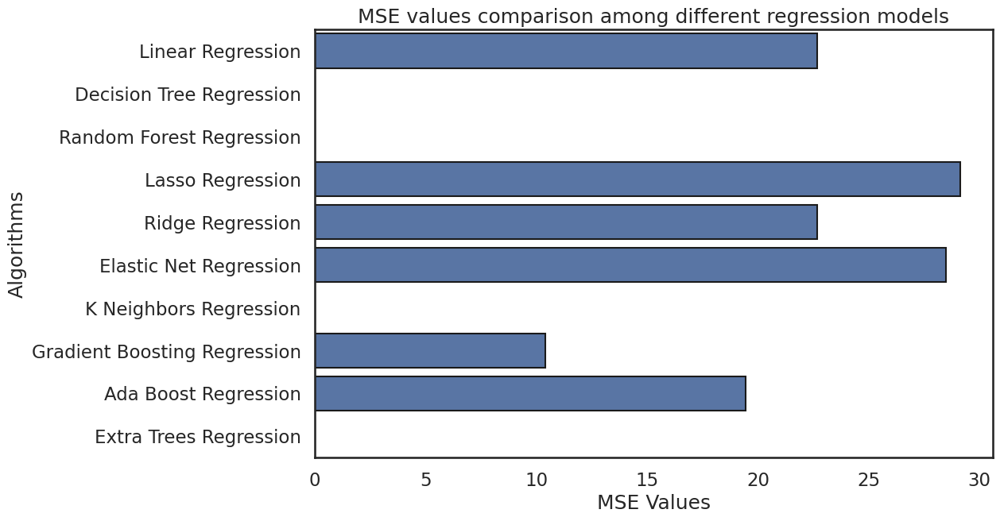

In [139]:
sns.set(rc={'figure.figsize':(11,7)})

sns.set_style("white")

sns.set_context("talk")
pt.xlabel("MSE Values")
pt.ylabel("Algorithms")
pt.title('MSE values comparison among different regression models')

sns.barplot(x = x_ax, y = y_ax, linewidth = 1.5, edgecolor = "0.1")

In [140]:
# Check if the variable was defined in a previous cell or module
try:
    sv_r2
except NameError:
    # If the variable is not defined, assign it a value
    sv_r2 = 0.0

# Create a list of all the mean squared errors
mse = [lr_mse, dt_mse, sv_mse, lasso_mse, ridge_mse, en_mse, kn_mse, gb_mse, ab_mse, et_mse]

# Print the list of mean squared errors
print(mse)

[22.66592782962712, 3.603177943655736e-27, 0.0, 29.13187447563383, 22.66581577103307, 28.483586082926575, 0.0, 10.414917144633256, 19.43331626755446, 5.672793283225081e-10]


In [141]:
y_ax=['Linear Regression' ,'Decision Tree Regression','Support Vector Regression', 'Lasso Regression', 'Ridge Regression', 'Elastic Net Regression', 'K Neighbors Regression', 'Gradient Boosting Regression', 'Ada Boost Regression', 'Extra Trees Regression']
r2 = [lr_r2, dt_r2, sv_r2, lasso_r2, ridge_r2, en_r2, kn_r2, gb_r2, ab_r2, et_r2]
x_ax = r2

<Axes: title={'center': 'R2 Scores comparison among different regression models'}, xlabel='R2 Scores', ylabel='Algorithms'>

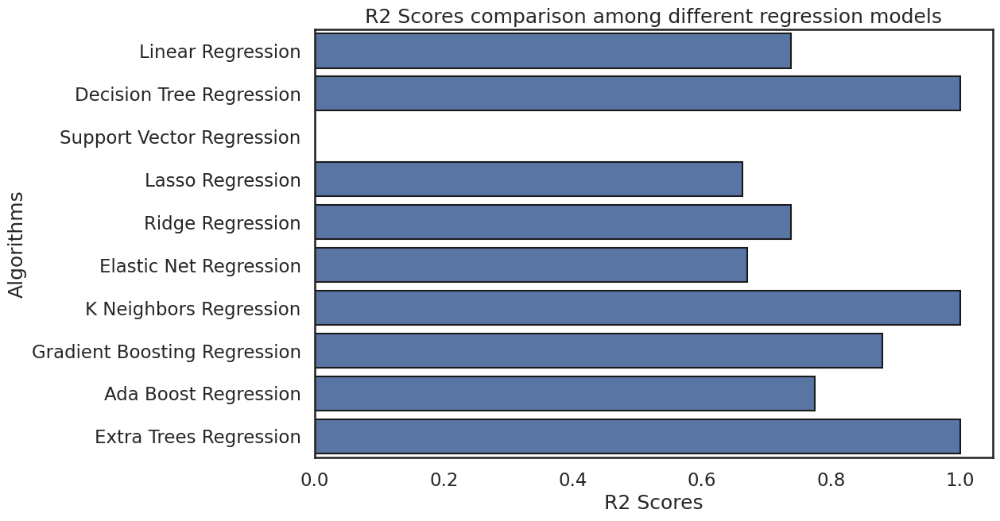

In [142]:
sns.set(rc={'figure.figsize':(11,7)})

sns.set_style("white")

sns.set_context("talk")
pt.xlabel("R2 Scores")
pt.ylabel("Algorithms")
pt.title('R2 Scores comparison among different regression models')

sns.barplot(x = x_ax, y = y_ax, linewidth = 1.5, edgecolor = "0.1")

# **Models Evaluations**

In [143]:
df = pd.DataFrame({'Algorithms': y_ax, 'MSE Values': mse, 'R2 Values':r2})
df

,Algorithms,MSE Values,R2 Values
0,Linear Regression,2.266593e+01,0.737240
1,Decision Tree Regression,3.603178e-27,1.000000
2,Support Vector Regression,0.000000e+00,0.000000
3,Lasso Regression,2.913187e+01,0.662282
4,Ridge Regression,2.266582e+01,0.737241
5,Elastic Net Regression,2.848359e+01,0.669797
6,K Neighbors Regression,0.000000e+00,1.000000
7,Gradient Boosting Regression,1.041492e+01,0.879263
8,Ada Boost Regression,1.943332e+01,0.774715
9,Extra Trees Regression,5.672793e-10,1.000000


We can see from upper table Extra Trees Regression give highest R2 score and lowest MSE value. So, we can take this Algorithm for prediction tasks.: